In [2]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pylab as plt
import matplotlib.colors as colors
import matplotlib.patches as patches
import torchvision
import matplotlib.patches as patches
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D

import os
import time
import torch
import sys
import argparse
sys.path.insert(0, '../code')
from model_loader_func import * 
from dataloader_func import *
from quality_metrics_func import *
from linear_approx import *
from plotting_func import *
from algorithm_inv_prob import * 
from trainer import make_loader
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
print(torch.__version__)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

2.5.0+cu124


device(type='cuda')

# functions 

In [5]:
## plotting stuff: 
noise_colormap = plt.cm.copper 
scale_colormap = plt.cm.seismic


In [6]:
similarity_matrix = lambda data : data/data.norm(dim = 1, keepdim=True) @(data/data.norm(dim = 1, keepdim=True)).T
similarity_matrix_2mats = lambda data1, data2 : data1/data1.norm(dim = 1, keepdim=True) @(data2/data2.norm(dim = 1, keepdim=True)).T

degree_matrix = lambda sim_mat : torch.diag(sim_mat.sum(dim = 1))

participation_ratio = lambda v :  (v.norm(1)**2)/v.norm(2)**2/len(v)
participation_ratio_dataset = lambda data :  (data.norm(1, dim = 1)**2)/data.norm(2,dim = 1)**2/data.shape[1]


# Load denoisers 

In [8]:
denoisers = {}

root_path = '../denoisers/'

paths = {              
         'mixture-color-deep-no-skip-256mid':'UNet_flex/imagenet/0to255_RF_84x84_set_size_1232457_color_no_skip_deep_dec_256mid_64x64/',    
         'mixture-color-deep-no-skip':'UNet_flex/imagenet/0to255_RF_84x84_set_size_1232457_color_no_skip_deep_dec_64x64/',
         'mixture-color-deep-no-skip-1024mid':'UNet_flex/imagenet/0to255_RF_68x68_set_size_1232457_color_no_skip_deep_dec_1024mid_64x64/',
    
   
        }

groups = paths.keys()


for group in groups: 
    path = root_path + paths[group]
    
    print('loading group ' , group )
    if 'modified' in group.split('-'):
        new_arch = 'UNet_conditional_mean_matching'
    else: 
        new_arch = None
    denoisers[group] = load_learned_model(path, print_args=True, new_arch=new_arch)
    start_time_total = time.time()        
    print("--- %s seconds ---" % (round(time.time() - start_time_total)))
     

loading group  mixture-color-deep-no-skip-256mid
*************** saved arguments:*************
arch_name UNet_flex
lr 0.001
batch_size 1024
num_epochs 1500
lr_freq 100
loss_weight False
noise_level_range [0, 255]
quadratic_noise True
rescale False
swap False
set_size 1232457
imagenet_subset_ids None
data_name imagenet
data_root_path /mnt/home/zkadkhodaie/ceph/datasets/
dir_name /mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/UNet_flex/imagenet/0to255_RF_84x84_set_size_1232457_color_no_skip_deep_dec_256mid_64x64
optional_dir_label color_no_skip_deep_dec_256mid
device cuda
debug False
kernel_size 3
padding 1
skip False
num_channels 3
bias True
RF 84
coarse True
self_cond False
num_kernels [64, 128, 256, 256]
num_blocks 3
num_enc_conv [2, 2, 2]
num_mid_conv 3
num_dec_conv [6, 6, 6]
NormType LayerNorm
inter_skip True
dilations None
upsample_with_bias False
data_path /mnt/home/zkadkhodaie/ceph/datasets/imagenet
******************************************************
n

In [9]:
denoisers.keys()

dict_keys(['mixture-color-deep-no-skip-256mid', 'mixture-color-deep-no-skip', 'mixture-color-deep-no-skip-1024mid'])

In [10]:
layers = {}
for group in groups:
    layers[group] = []
    for i in range(len(denoisers[group].encoder)):
        layers[group].append(denoisers[group].encoder[str(i) ][0].weight.shape[0])
    
    layers[group].append(denoisers[group].mid[0].weight.shape[0])
    
    for i in range(len(denoisers[group].decoder)-1 , 0, -1):
        layers[group].append(denoisers[group].decoder[str(i) ][0].weight.shape[0])


layers

{'mixture-color-deep-no-skip-256mid': [64, 128, 256, 256, 256, 128],
 'mixture-color-deep-no-skip': [64, 128, 256, 512, 256, 128],
 'mixture-color-deep-no-skip-1024mid': [64, 128, 256, 1024, 256, 128]}

In [11]:
block_names = {}
for group in groups: 
    block_names[group] = []
    for l in range(int(len(layers[group])/2)): 
        block_names[group].append('enc' + str(l))
    block_names[group].append('mid'  )        
    for l in range(int(len(layers[group])/2)-1, 0,-1):
        block_names[group].append('dec' + str(l) )
block_names   

{'mixture-color-deep-no-skip-256mid': ['enc0',
  'enc1',
  'enc2',
  'mid',
  'dec2',
  'dec1'],
 'mixture-color-deep-no-skip': ['enc0', 'enc1', 'enc2', 'mid', 'dec2', 'dec1'],
 'mixture-color-deep-no-skip-1024mid': ['enc0',
  'enc1',
  'enc2',
  'mid',
  'dec2',
  'dec1']}

# Load datasets 

In [12]:
time0 = time.time()
test_sets = torch.load( '/mnt/home/zkadkhodaie/ceph/datasets/imagenet/test_64x64_color_list.pt', weights_only=True) 
print(f"loading time: {time.time() - time0} seconds ")
time0 = time.time()
val_sets = torch.load( '/mnt/home/zkadkhodaie/ceph/datasets/imagenet/validation_color_full_64x64_list.pt', weights_only=True) 
print(f"loading time: {time.time() - time0} seconds ")


loading time: 1.3533222675323486 seconds 
loading time: 1.3661315441131592 seconds 


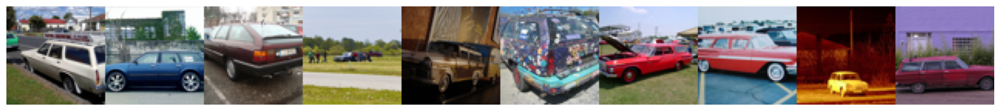

In [13]:
show_im_grid(test_sets[0][0:10] )


In [14]:
print('number of images in each class:', test_sets[0].shape)
K = test_sets[0].shape[2]
n_channels = test_sets[0].shape[1]
print(len(test_sets))

number of images in each class: torch.Size([49, 3, 64, 64])
999


tensor(0.4428)


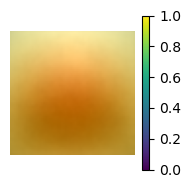

In [15]:
dist_mean = torch.concatenate(test_sets).mean(dim = (0))
plot_single_im(dist_mean, colorbar=True)
print(dist_mean.mean())

In [16]:
dist_mean.mean(dim = (1,2), keepdim = True)

tensor([[[0.4773]],

        [[0.4508]],

        [[0.4001]]])

In [15]:
test_sets_cat = torch.concatenate(test_sets)
test_sets_cat.shape

torch.Size([49051, 3, 64, 64])

In [17]:
# val_sets_cat = torch.concatenate(val_sets)
# val_sets_cat.shape

120


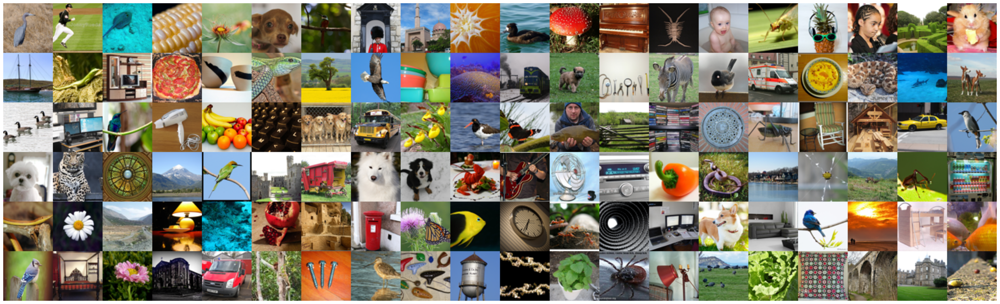

In [18]:
my_ids = [5, 31, 40, 46, 53, 58, 59,50+17, 50+45,104, 105, 117, 118, 124, 130,139 ,142, 150, 169, 179, 183, 186, 190,202, 209, 214, 229, 237, 260, 261, 275, 277, 288,291 , 307, 310, 316,336, 343,348,350,357,362,376,394,396, 
         408, 419, 440, 443, 459, 461, 486, 488,500, 524,525, 536, 546,570,572, 574, 576, 582,597, 603, 606,609, 615,622,636,651,660, 663,679,686, 692, 705,709,710,713,716,729, 746,747,752,761,763, 786,790,793,796, 
         802, 844, 846,851, 853,864,870,878,887,889, 891,  907, 909, 910, 919, 920, 921,930, 937,954, 956, 957,960, 968, 980, 992, 993,  995 ]

my_ims = torch.cat([test_sets[i][0:1] for i in my_ids ])
print(len(my_ids))
show_im_grid(my_ims, n_columns=20)



$\phi(y)$ or the mean of the channel is a function of noise realization, noise level, and input image. 

- **noise realization**: We take the average of $\phi(y)$ at a noise level, for one image to remove the effect of noise realization. 

- **noise level**: We observe that the $\phi(y_{\sigma})$ and $\phi(y_{\sigma})$ at two different noise levels are highly related: first, active channels are mostly shared at different noise levels. Specially at intermediate and larger noise levels. There are more active channels at high noise levels and they include active channels at smaller noise levels. Second, they are highly correlated. That means they are aligned and differ by a poitive scalre value.

- **input image $x$**: after getting rid of noise effect, we can look at how $\phi(y)$ changes from image to image. We can interpret $\phi(y)$ as a good approximation of $\phi(x)$. Now we ask if  Euclidean distance in latent space $\Vert \phi(x_1) -  \phi(x_2) \Vert_2$ is meaningfully related to $\mathcal{D}(x_1, x_2)$ where $\mathcal{D}$ is a some distance metric between the two images. Since $\phi(x)$ is a many to one mapping, we can define a distance between the density of all images mapping to $\phi(x_1)$ and the density of all images mapping to $\phi(x_2)$, that is $\mathcal{D}( p(x|\phi(x_1), p(x|\phi(x_2)) )$. 

In [19]:
# a_bars = torch.load('../results/phis_noise_ave_all_scales_64x64_mixture-color-no-skip-deep_imagenet.pt', weights_only=True)
a_bars = {}
for group in groups: 
    # a_bars[group] = torch.load('../results/a_bar_noise_ave_validation_full_'+group+'_imagenet64x64.pt', weights_only = True)
    a_bars[group] = torch.load('../results/a_bar_noise_ave_'+group+'_imagenet64x64.pt', weights_only = True)

    print(group)

mixture-color-deep-no-skip-256mid
mixture-color-deep-no-skip
mixture-color-deep-no-skip-1024mid


In [20]:
sigmas = list(a_bars[group].keys())
if sigmas[-1] < sigmas[0]:
    sigmas.reverse()
sigmas

[0, 10, 50, 150, 255, 510, 765]

In [21]:


phis = {}
for group in groups:
    phis[group] ={}
    for sig in a_bars[group].keys():
        mid = int(len(layers[group])/2)
        phis[group][sig] = [a_bars[group][sig][i][:, sum(layers[group][0:mid]): sum(layers[group][0:mid+1]) ] for i in range(len(a_bars[group][sig]))]
    

In [22]:
ch_selectivity = {}
ids_selectivity_sorted = {}
for group in groups:
    ch_selectivity[group] = {}
    ids_selectivity_sorted[group] = {}
    for sig in sigmas:
        
        ch_selectivity[group][sig] = participation_ratio_dataset(torch.cat(phis[group][sig]).T.cpu())
        # ch_selectivity[group][sig]= torch.nan_to_num(ch_selectivity[group][sig], nan=0.0)
        ids_selectivity_sorted[group][sig] = ch_selectivity[group][sig].sort(descending =True)[1]
  

## Always off channels 

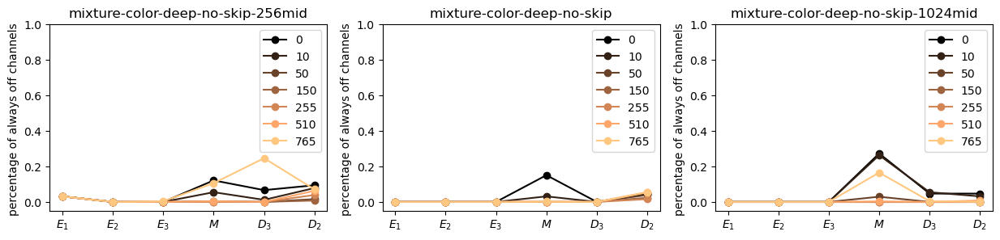

In [23]:
f, axs = plt.subplots(1, len(groups), figsize = ( len(groups)*5, 3) )
block_names = ['$E_1$','$E_2$' , '$E_3$', '$M$', '$D_3$','$D_2$']

j = 0
for group in groups:
    off_channels = {}
    for sig in sigmas:
        off_channels[sig] = []
        k1 = 0
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            off_channels[sig].append((phi_block.sum(dim = 0) == 0).sum().item())
            k1 += l  
            
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas ))]
    
    c = 0
    for sig in sigmas:    
        axs[j].plot(block_names, torch.tensor(off_channels[sig])/torch.tensor(layers[group]), '-o', color = plot_colors[c],  label = sig)
        c+= 1
    axs[j].set_ylabel('percentage of always off channels ');
    axs[j].set_ylim(-.05,1)
    axs[j].legend();
    axs[j].set_title(group);
    j += 1

#  Channel selectivity



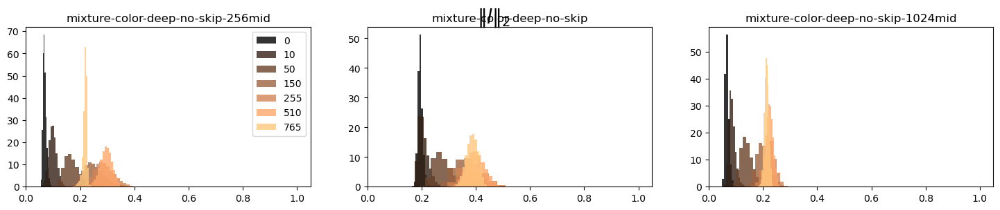

In [24]:
f, axs = plt.subplots(1 ,len(groups), figsize = (18,3))
plt.suptitle('$\Vert l \Vert_2 $', fontsize = 20)
i = 0
for group in groups:
    for s in range(len(sigmas)):
        sig = sigmas[s]
        axs[i].hist(torch.cat(phis[group][sig]).norm(2, dim = 1).cpu(), alpha = .8, label = sig, bins = 20, color=plot_colors[s], density=True);
        axs[i].set_title(group )   ;
        axs[i].set_xlim(0, 1.05)
    i += 1
axs[0].legend();

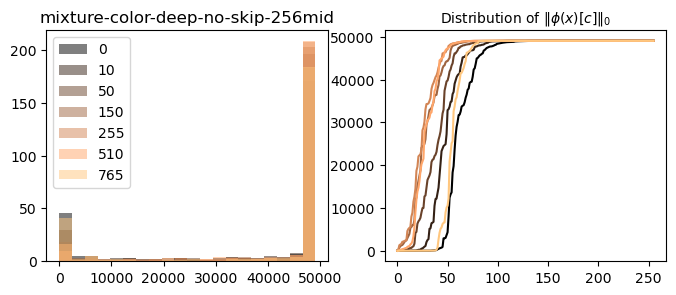

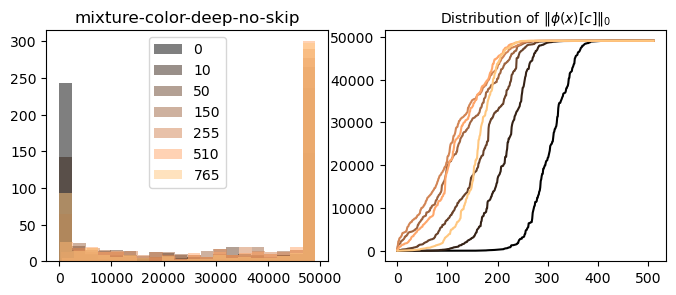

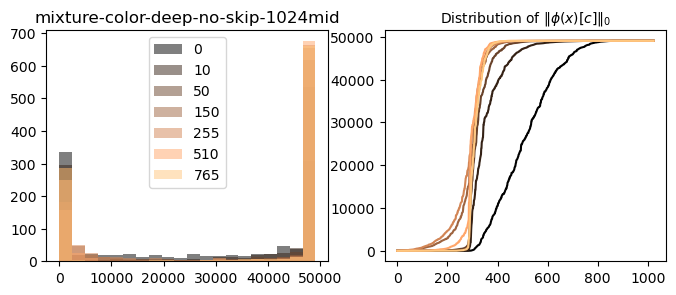

In [211]:
for group in groups:
    f, axs = plt.subplots(1,2, figsize = (8,3))
    i = 0
    for sig in sigmas:
        axs[0].hist(torch.cat(phis[group][sig]).norm(0, dim = 0).cpu(), alpha = .5, label = sig, bins = 20, color=plot_colors[i]);
        axs[1].plot(torch.cat(phis[group][sig]).norm(0, dim = 0).cpu().sort()[0], label = sig, color=plot_colors[i]);    
        axs[0].legend()
        i += 1
    axs[1].set_title('Distribution of $\Vert \phi(x)[c] \Vert_0$', fontsize = 10)   ;
    axs[0].set_title(group )   ;
    # print(group)    

The binary nature of the sparsity is interesting! There are some channels that are very selective. And some channels that are respond to all images. The around 100 channels that are in between 

The average $\phi$ per channel is small for most channels expect a handful. 

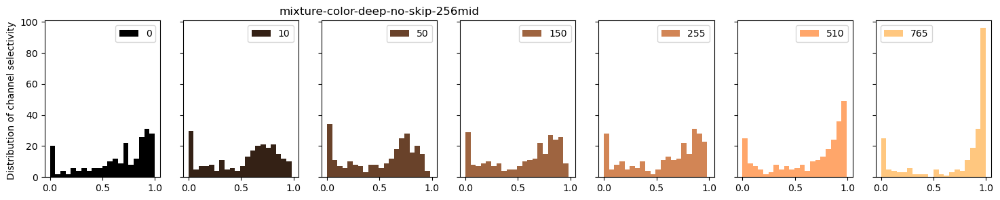

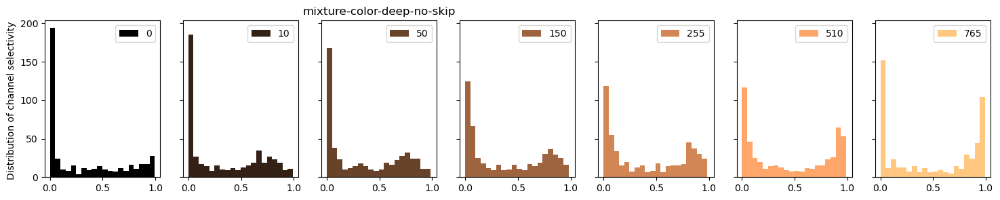

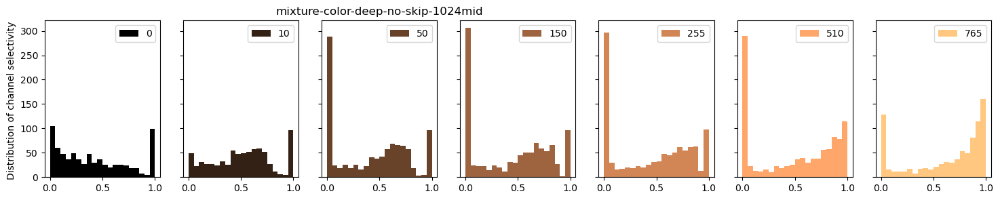

In [215]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(a_bars[group ].keys()))]

for group in groups:
    f, axs = plt.subplots(1,len(sigmas) , figsize = (18,3), sharey=True, sharex=True)
    i = 0 
    for sig in sigmas:
        axs[i].hist(ch_selectivity[group][sig], alpha = 1, label = sig, bins = 20, color = plot_colors[i]);   
        axs[i].legend()    
        i += 1
    axs[0].set_ylabel('Distribution of channel selectivity ')   ;
    axs[2].set_title(group )

        
    # print(group)

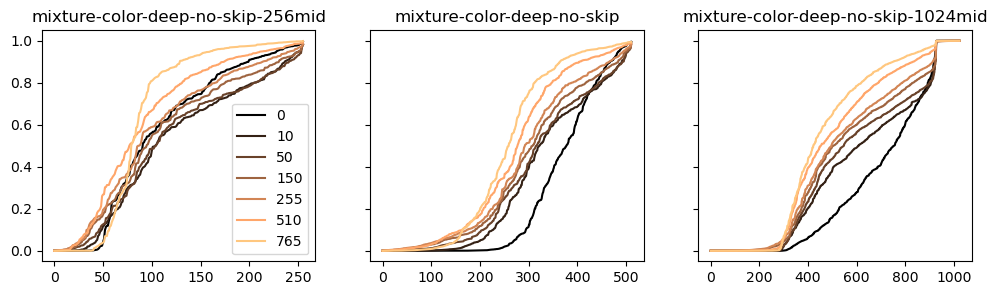

In [213]:
f, axs = plt.subplots(1,len(groups) , figsize = (4*len(groups),3), sharey=True, sharex=False)
c = 0
for group in groups:
    j = 0
    for sig in sigmas:
        axs[c].plot(ch_selectivity[group][sig].sort()[0], label = sig, color = plot_colors[j]);    
        
        j += 1
    axs[c].set_title(group)        
    c += 1
axs[0].legend();        
    

## channel selectivity at other blocks

In [166]:
sigmas

[0, 10, 50, 150, 255]

In [216]:
# other blocks 


ch_selectivity_all_scales = {}
for group in groups:
    ch_selectivity_all_scales[group] ={}
    for sig in sigmas:    
        ch_selectivity_all_scales[group][sig] = []
        k1 = 0
    
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            
            # ch_selectivity_all_scales[group][sig].append(participation_ratio_dataset(phi_block.T).cpu())
            ch_selectivity_all_scales[group][sig].append(torch.nan_to_num(participation_ratio_dataset(phi_block.T).cpu(), nan = 0.0))
            k1 += l     
            



In [217]:
# other blocks 


sparsity_all_scales = {}
for group in groups:
    sparsity_all_scales[group] ={}
    for sig in sigmas:    
        sparsity_all_scales[group][sig] = []
        k1 = 0
    
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            
            # sparsity_all_scales[group][sig].append(participation_ratio_dataset(phi_block).cpu())
            sparsity_all_scales[group][sig].append(torch.nan_to_num(participation_ratio_dataset(phi_block).cpu(), nan = 0.0))
            k1 += l     
  

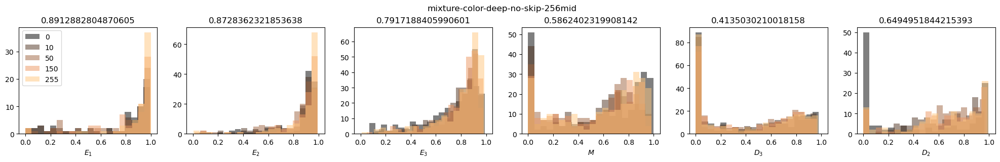

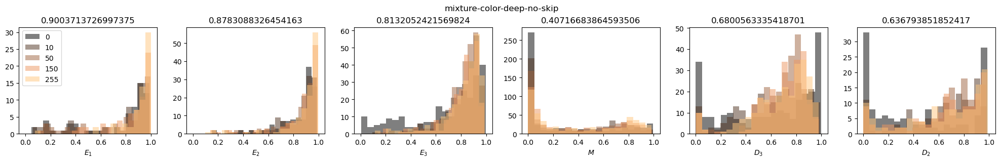

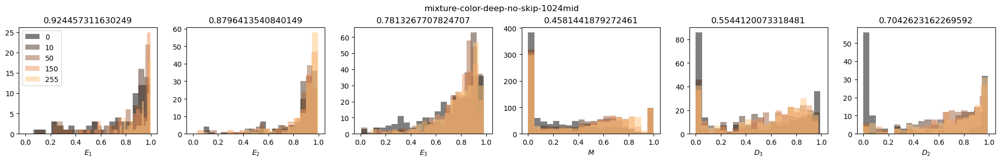

In [186]:
for group in groups:
    f, axs = plt.subplots(1 ,6, figsize = (20, 3))
    f.suptitle(group)
    plt.tight_layout()
    
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas))]
    
    for b in range(len(layers[group])):
        for i, sig in zip(range(len(sigmas)),sigmas):        
            axs[b].hist(ch_selectivity_all_scales[group][sig][b].flatten(), bins = 20, color= plot_colors[i] , alpha = .5, label = sig)
        axs[b].set_xlim(-.05, 1.05)
        axs[b].set_xlabel(block_names[b])
        axs[b].set_title(ch_selectivity_all_scales[group][sig][b].mean().item())
    
    axs[0].legend();


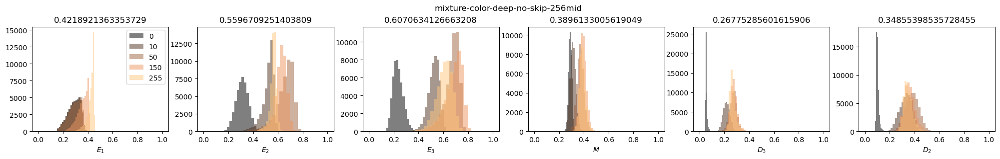

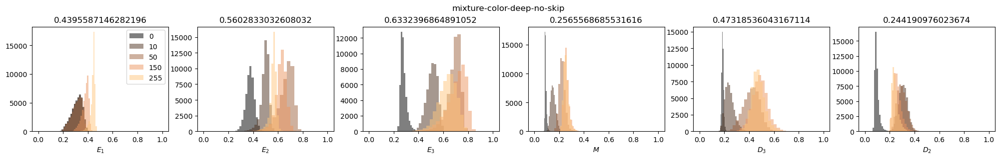

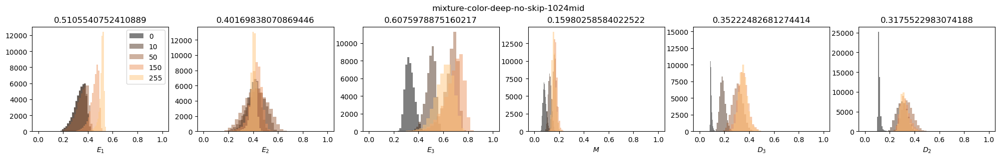

In [192]:
for group in groups:
    f, axs = plt.subplots(1 ,6, figsize = (20, 3))
    f.suptitle(group)
    plt.tight_layout()
    
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas))]
    
    for b in range(len(layers[group])):
        for i, sig in zip(range(len(sigmas)),sigmas):        
            axs[b].hist(sparsity_all_scales[group][sig][b].flatten(), bins = 20, color= plot_colors[i] , alpha = .5, label = sig)
        axs[b].set_xlim(-.05, 1.05)
        axs[b].set_xlabel(block_names[b])
        axs[b].set_title(sparsity_all_scales[group][sig][b].mean().item())
    
    axs[0].legend();



# 4) Specialized vs. Common channels

## Top images that activate a channel

channels selectivity:  0.25595566630363464


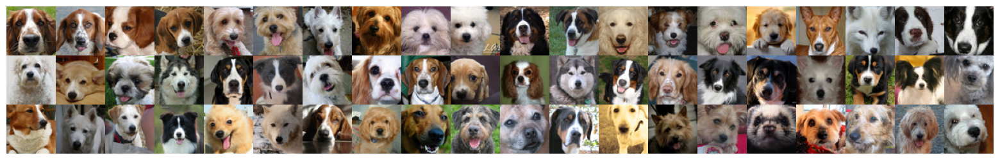

channels selectivity:  0.01790199987590313


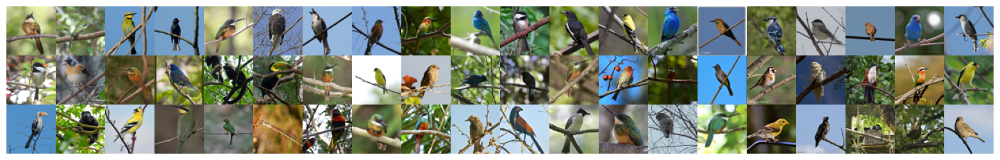

channels selectivity:  0.28062567114830017


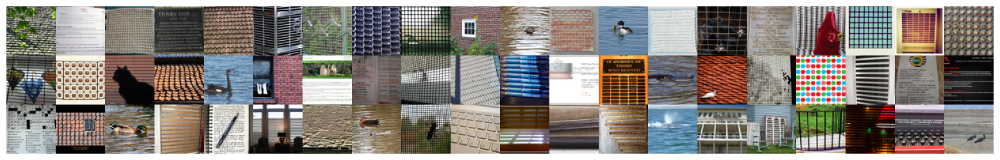

channels selectivity:  0.18790565431118011


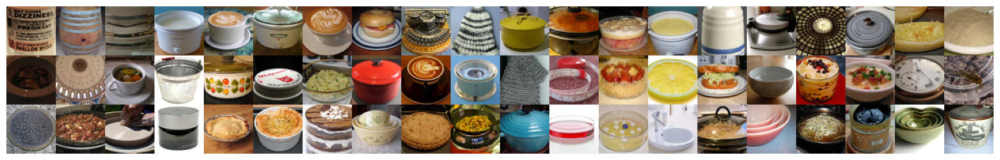

In [26]:
## channels shown in the paper: 144, 77,341, 311 
sig = 50
group  = 'mixture-color-deep-no-skip'


for ch_n in [144, 77,341, 311 ]:
    # ch_n = ids_selectivity_sorted[group][sig][i] 
    print('channels selectivity: ', ch_selectivity[group][sig][ch_n].item()  )

    p = min(60, round(ch_selectivity[group][sig][ch_n].item() * test_sets_cat.shape[0]))
    show_im_grid(test_sets_cat[torch.cat(phis[group][sig])[:,ch_n].cpu().sort(descending = True)[1][0:p]], 
                 n_columns= 20 , im_size=1)
    # show_im_grid(torch.cat(test_sets)[torch.cat(phis[50])[:,77].cpu().sort(descending = True)[1][0:25]], n_columns= 5 , im_size=1, return_image=False)
    # plt.savefig( '../results/channel77.png',bbox_inches='tight')  

channels selectivity:  661


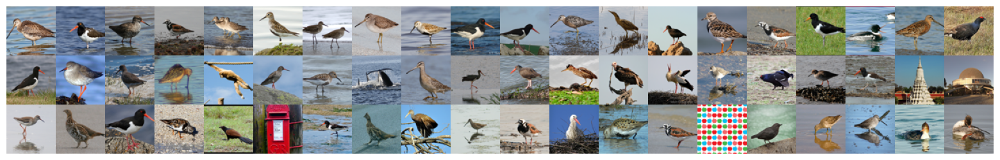

channels selectivity:  638


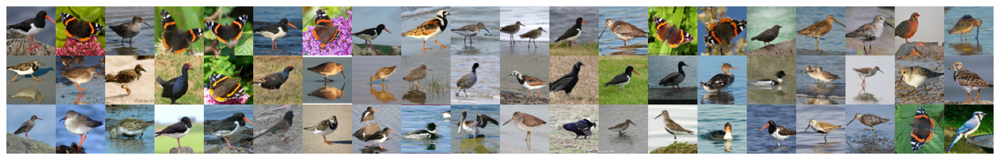

channels selectivity:  617


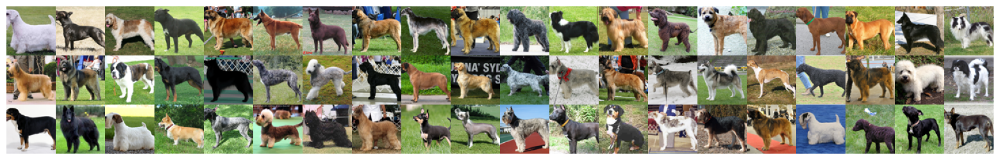

channels selectivity:  616


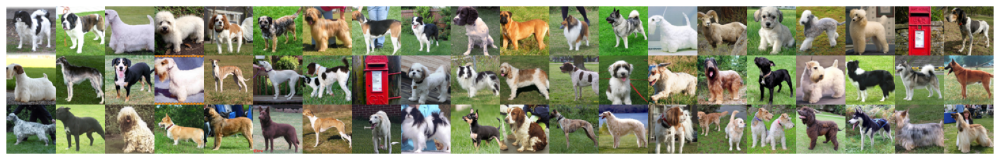

channels selectivity:  581


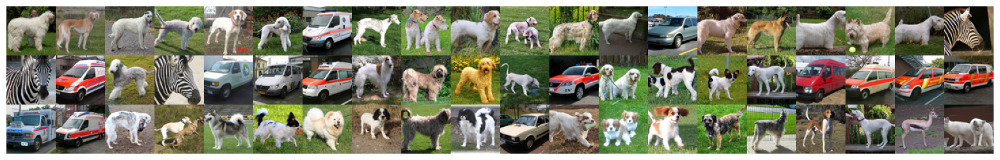

channels selectivity:  578


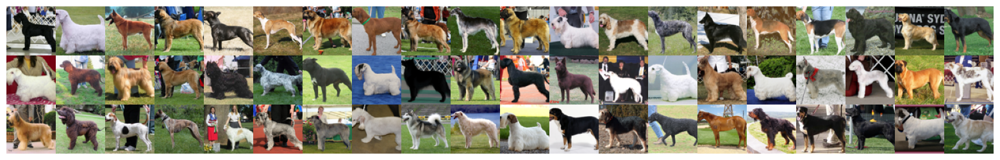

channels selectivity:  531


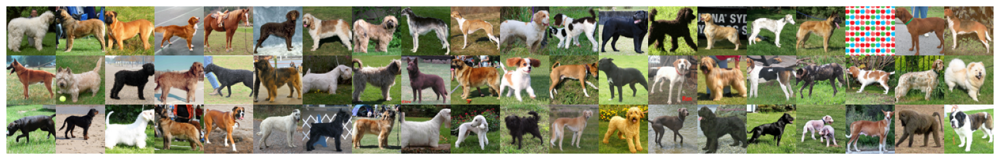

channels selectivity:  522


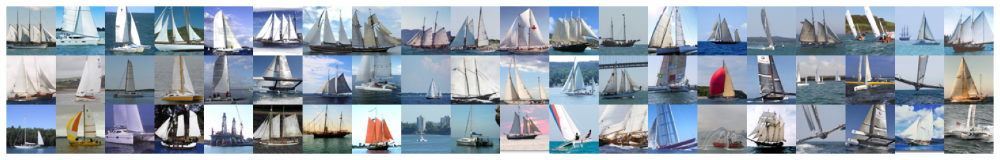

channels selectivity:  510


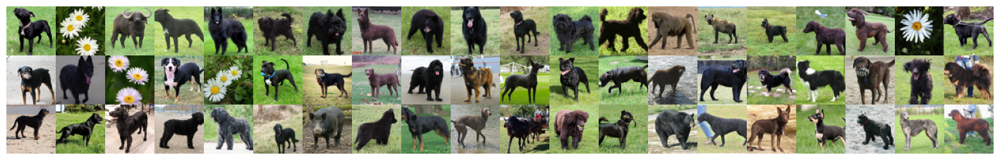

channels selectivity:  484


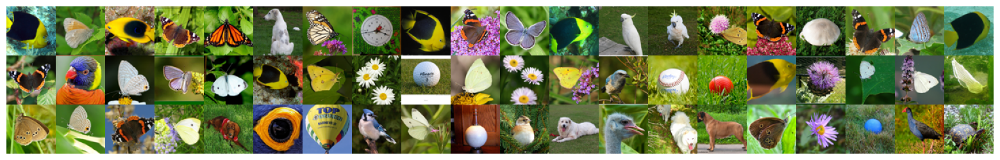

In [70]:
## channels shown in the paper: 144, 77,341, 311 
sig = 150
group  = 'mixture-color-deep-no-skip'


for i in range(450,460):
    ch_n = ids_selectivity_sorted[group][sig][i] 
    print('channels selectivity: ',  round(ch_selectivity[group][sig][ch_n].item() * test_sets_cat.shape[0] ) )

    p = min(60, round(ch_selectivity[group][sig][ch_n].item() * test_sets_cat.shape[0]))
    show_im_grid(test_sets_cat[torch.cat(phis[group][sig])[:,ch_n].cpu().sort(descending = True)[1][0:p]], 
                 n_columns= 20 , im_size=1)
    # show_im_grid(torch.cat(test_sets)[torch.cat(phis[50])[:,77].cpu().sort(descending = True)[1][0:25]], n_columns= 5 , im_size=1, return_image=False)
    # plt.savefig( '../results/channel77.png',bbox_inches='tight')  

506
channels selectivity:  0


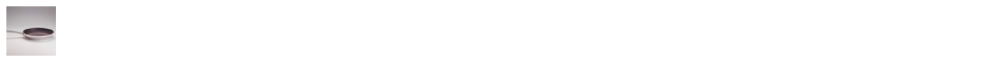

channels selectivity:  2


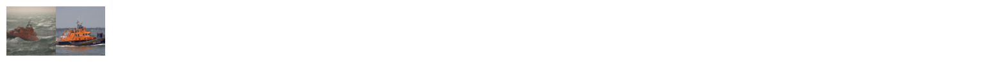

channels selectivity:  27


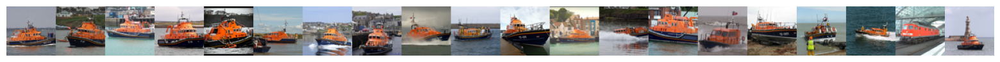

channels selectivity:  83


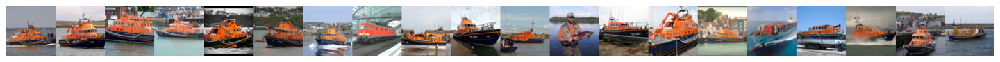

channels selectivity:  144


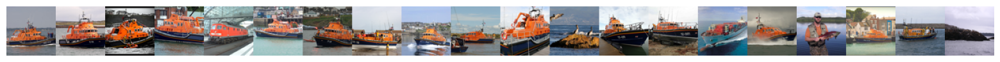

In [74]:
group  = 'mixture-color-deep-no-skip'

ch_n = torch.randint(0, layers[group][3], size = (1,)).item()
print(ch_n)
for sig in sigmas:    
    p = min(20, round(ch_selectivity[group][sig][ch_n].item() * test_sets_cat.shape[0]))    
    if p ==0: 
        p = 1
    print('channels selectivity: ',  round(ch_selectivity[group][sig][ch_n].item() * test_sets_cat.shape[0]))

    show_im_grid(test_sets_cat[torch.cat(phis[group][sig])[:,ch_n].cpu().sort(descending = True)[1][0:p]], 
                 n_columns= 20 , im_size=1)
    # show_im_grid(torch.cat(test_sets)[torch.cat(phis[50])[:,77].cpu().sort(descending = True)[1][0:25]], n_columns= 5 , im_size=1, return_image=False)
    # plt.savefig( '../results/channel77.png',bbox_inches='tight')    


## Distribution of $\phi$ within each channel 
common channels are Gaussian. Specialized channels are not 

In [25]:
group  = 'mixture-color-deep-no-skip'


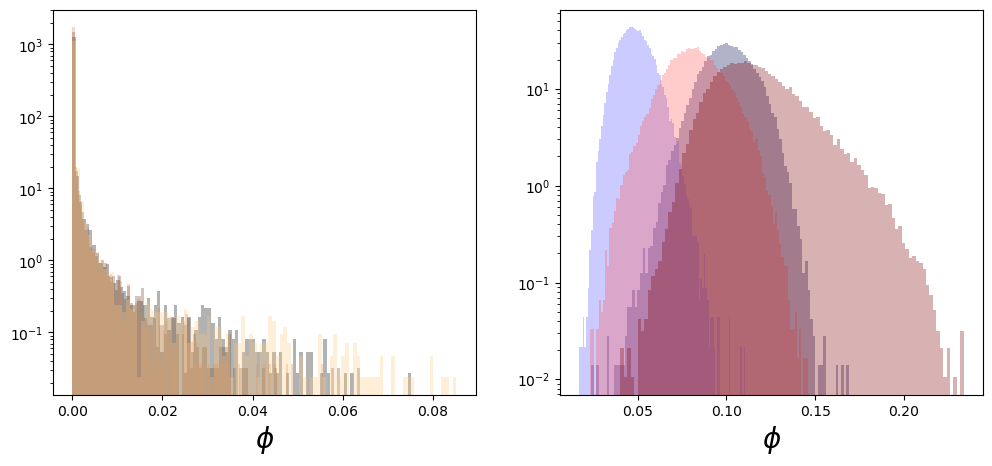

In [30]:
sig = 150 
f, axs = plt.subplots(1,2, figsize = (12,5), sharex= False, sharey = False)
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, 4 )]
i = 0
for id in ids_selectivity_sorted[group][sig][-60:-56]: 
    axs[0].hist(   torch.cat(phis[group][sig]).cpu()[:, id ], bins = 100, alpha = .3 , density = True, color = plot_colors[i], label = id) ;
    i+=1
# axs[0].set_title('distribution of $\phi$ in 10 specialized channels',fontsize = 15 )
plot_colors = [scale_colormap(i) for i in np.linspace(0, 1, 4 )]
i = 0

for id in ids_selectivity_sorted[group][sig][0:4]: 
    axs[1].hist(   torch.cat(phis[group][sig]).cpu()[:, id ], bins = 100, alpha = .3 , density = True, color =plot_colors[i], label = id) ;
    i+=1

# axs[1].set_title('distribution of $\phi$ in 4 common channels' ,fontsize = 15)
# axs[0].legend()
# axs[1].legend();
axs[0].set_xlabel('$\phi$',fontsize = 20)
axs[1].set_xlabel('$\phi$',fontsize = 20)

axs[0].set_yscale('log')
axs[1].set_yscale('log')
plt.savefig( '../results/marginals_imagenet.png',bbox_inches='tight')  

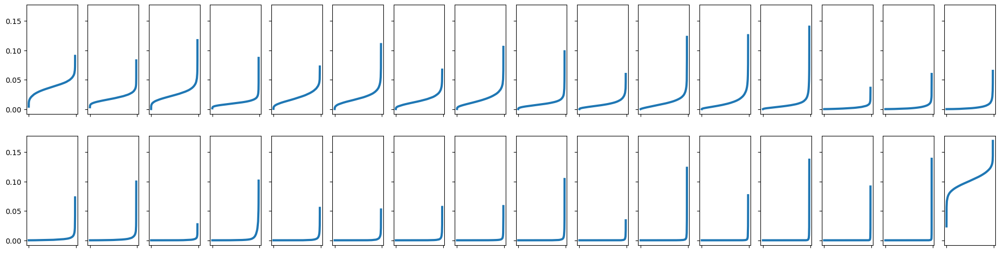

In [79]:
f, axs = plt.subplots(2,16, figsize = (16 * 1.5, 4* 1.5), sharex = True, sharey = True)
axs = axs.ravel()
for i in range(0,32) : 
    axs[i-1].plot(torch.cat(phis[group][sig]).cpu()[:,ids_selectivity_sorted[group][sig]][:,i * 16].sort()[0] , lw = 3)
    axs[i-1].set_xticklabels([])
# plt.savefig('../results/channel_activations_sorted.pdf',bbox_inches='tight')    


## Joint distribution of common channels and specialized channels 

Text(0.5, 1.0, 'joint density b/w two common channels')

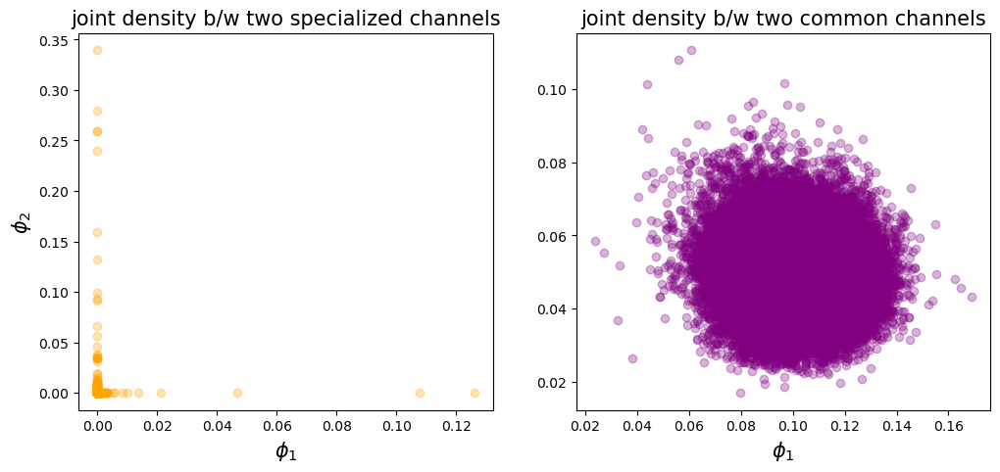

In [26]:
sig = 150 
f, axs = plt.subplots(1,2, figsize = (12,5), sharex= False, sharey = False)

axs[0].scatter(torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][-1:] ],
               torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][-2:-1] ], 
               alpha = .3 ,  label = id ,color = 'orange') ;

axs[1].scatter(torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][0:1] ],
               torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][1:2] ], 
               alpha = .3 ,  label = id,  color = 'purple' );
axs[0].set_xlabel('$\phi_1$', fontsize = 15)
axs[1].set_xlabel('$\phi_1$', fontsize = 15)
axs[0].set_ylabel('$\phi_2$', fontsize = 15)
axs[0].set_title('joint density b/w two specialized channels', fontsize = 15)
axs[1].set_title('joint density b/w two common channels', fontsize = 15)


## Common channels are also spatially denser (capture lower frequencies)
Generally, spatial sparsity is even lower than channel sparsity

torch.Size([999, 512, 8, 8])


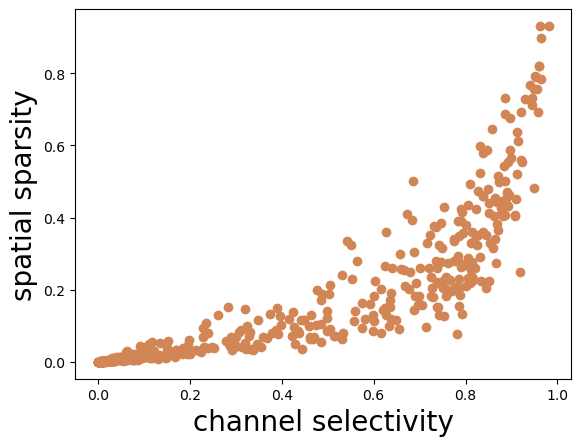

In [28]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas) )]
i = 4
sig = 150
group  = 'mixture-color-deep-no-skip'
clean_inp = torch.cat([test_sets[k][0:1] for k in range(999)]) 
# clean_inp = test_sets[0]

noisy_inp =clean_inp + torch.randn_like(clean_inp) * sig/255
# _ , acts = get_channel_means(denoisers[group], noisy_inp, return_activations=True )

acts = get_activations_unconditional(denoisers[group], noisy_inp, noGrad=True)
print(acts[3].shape)
# spatial sparsity 
spatial_sparsity = []
for c in range(layers[group][3]):
    spatial_sparsity.append(torch.nan_to_num(participation_ratio_dataset(acts[3][:,c].flatten(start_dim = 1)), nan=0).mean())


plt.scatter(  ch_selectivity[group][sig] , torch.stack(spatial_sparsity).flatten().cpu() , color = plot_colors[i]) 
i += 1
# plt.title(group)
plt.xlabel('channel selectivity', fontsize = 20 )
plt.ylabel('spatial sparsity', fontsize = 20);
plt.savefig( '../results/ch_selectivity_spatial_sparsity_imagenet.png',bbox_inches='tight')  

torch.Size([999, 512, 8, 8])
torch.Size([999, 512, 8, 8])
torch.Size([999, 512, 8, 8])
torch.Size([999, 512, 8, 8])
torch.Size([999, 512, 8, 8])


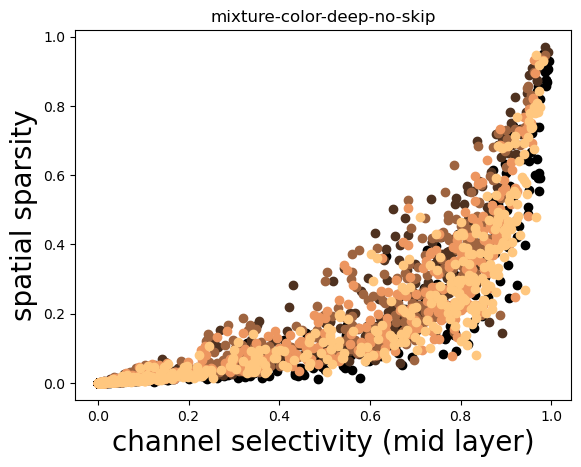

In [80]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas) )]
i = 0

group  = 'mixture-color-deep-no-skip'
for sig in sigmas:
    clean_inp = torch.cat([test_sets[k][0:1] for k in range(999)]) 
    # clean_inp = test_sets[0]
    
    noisy_inp =clean_inp + torch.randn_like(clean_inp) * sig/255
    # _ , acts = get_channel_means(denoisers[group], noisy_inp, return_activations=True )
    
    acts = get_activations_unconditional(denoisers[group], noisy_inp, noGrad=True)
    print(acts[3].shape)
    # spatial sparsity 
    spatial_sparsity = []
    for c in range(layers[group][3]):
        spatial_sparsity.append(torch.nan_to_num(participation_ratio_dataset(acts[3][:,c].flatten(start_dim = 1)), nan=0).mean())
    
    
    plt.scatter(  ch_selectivity[group][sig] , torch.stack(spatial_sparsity).flatten().cpu() , color = plot_colors[i]) 
    i += 1
    plt.title(group)
plt.xlabel('channel selectivity (mid layer)', fontsize = 20 )
plt.ylabel('spatial sparsity', fontsize = 20);


## PCA of channel responses
specializd channels are more concentrated \
common channels are higher dimensional 

In [29]:
from sklearn.decomposition import PCA


In [30]:
group  = 'mixture-color-deep-no-skip'

sig = 150

clean_inp = torch.cat([test_sets[k][0:1] for k in range(999)]) 
# clean_inp = test_sets[0]

noisy_inp =clean_inp + torch.randn_like(clean_inp) * sig/255
# _ , acts = get_channel_means(denoisers[group], noisy_inp, return_activations=True )

acts = get_activations_unconditional(denoisers[group], noisy_inp, noGrad=True)

In [31]:
# Create pca model

pca_model = PCA(n_components=64)
# Fit model
PC = []
exp_var = []
for i in range(layers[group][3]):
    PC.append(torch.tensor(pca_model.fit_transform(acts[3][:, i].flatten(start_dim = 1).cpu().T )) )
    exp_var.append(torch.tensor(pca_model.explained_variance_ratio_) )
PC = torch.stack(PC).unsqueeze(1)


In [32]:
PC.shape

torch.Size([512, 1, 64, 64])

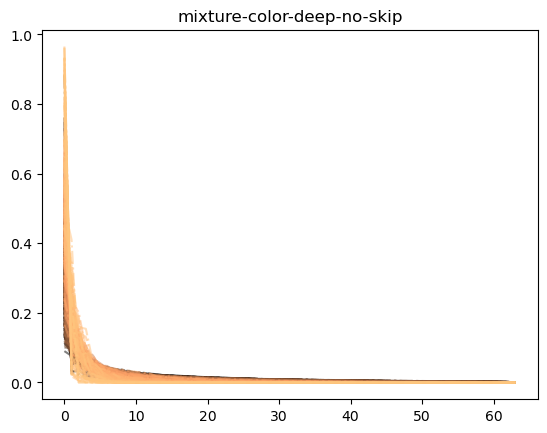

In [33]:
colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1,layers[group][3])]

for i in range(layers[group][3]):
    plt.plot(torch.stack(exp_var)[ids_selectivity_sorted[group][150]][i,:], '-.',color = plot_colors[i], alpha = .5)
plt.title(group);

Text(0, 0.5, 'cumulative explained variance')

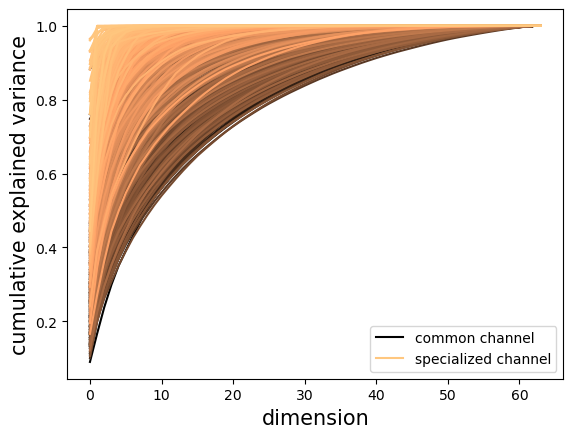

In [34]:
### 
colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1,512)]

plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[0,:] , color = plot_colors[0], label = 'common channel' ) 

for i in range(1,512):
    plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[i,:] , color = plot_colors[i] ) 

# for i in range(-100,-1):
#     plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[i,:] , color = plot_colors[i] ) 

plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[-1,:] , color = plot_colors[-1], label = 'specialized channel' ) 

plt.legend()
plt.xlabel('dimension', fontsize = 15)
plt.ylabel('cumulative explained variance', fontsize = 15)

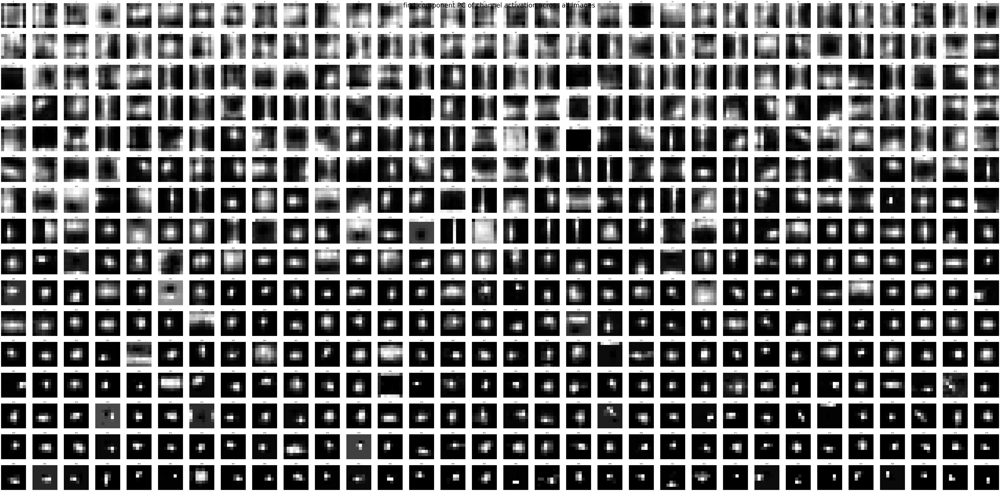

150


In [87]:
show_im_set(PC[:,:,:,0:1].reshape(512,1,8,8)[ids_selectivity_sorted[group][sig]], n_columns=32 , 
             label= 'first component PC of channel activation across all images', font_size=30)
print(sig)

## Common vs specialzied channels are different in their noise resistance 
common channels grow linearly with noise, and specialized channels go up and come down 

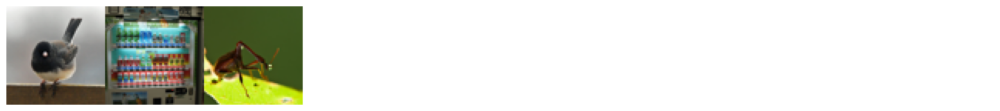

In [94]:
## for many images 


ids = torch.randint(0,len(my_ims), (3,))
inp_ims = my_ims[ids]
noise = torch.randn_like(inp_ims)

plot_colors = [scale_colormap(i) for i in np.linspace(0, 1,len(inp_ims))]

if 'gray' in group.split('-'): 
    inp_ims = inp_ims.mean(dim = 1, keepdim = True)

sigmas= range(0,256, 10)

all_phis  = {}

for sig in sigmas: 
    inp_ims_noisy = inp_ims + noise * (sig/255) 
    phi_xc = get_activation_means_unconditional(denoisers[group], inp_ims_noisy)
    all_phis[sig] = phi_xc


temp = torch.stack([all_phis[sig][3].squeeze() for sig in sigmas]).cpu()
show_im_grid(inp_ims)

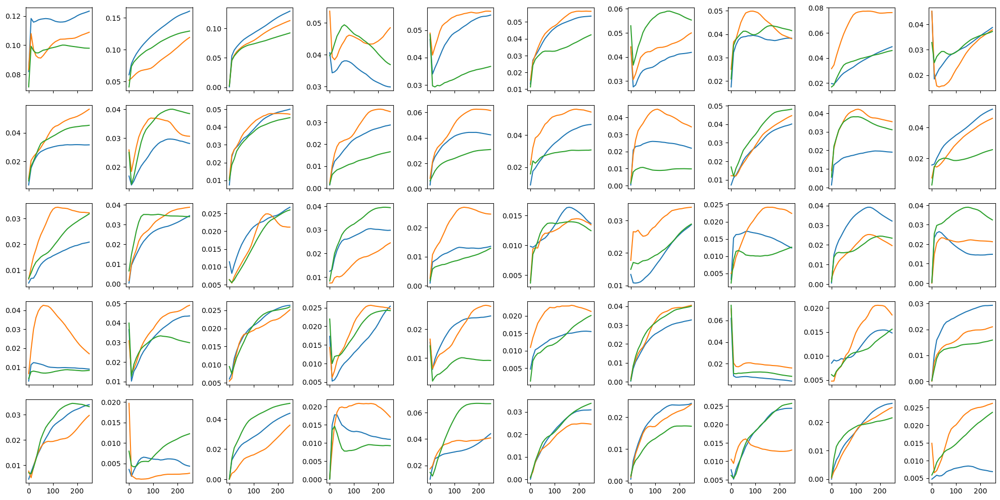

In [95]:
sig = 50
f, axs = plt.subplots(5,10, figsize = (20,10), sharey = False, sharex=True)
plt.tight_layout()

axs = axs.ravel()
for i in range(np.prod(axs.shape)):
    ch = i 
    for im in range(temp.shape[1]):
        axs[i].plot(sigmas, temp[:,im, :][:,ids_selectivity_sorted[group][sig] ][:,ch] )



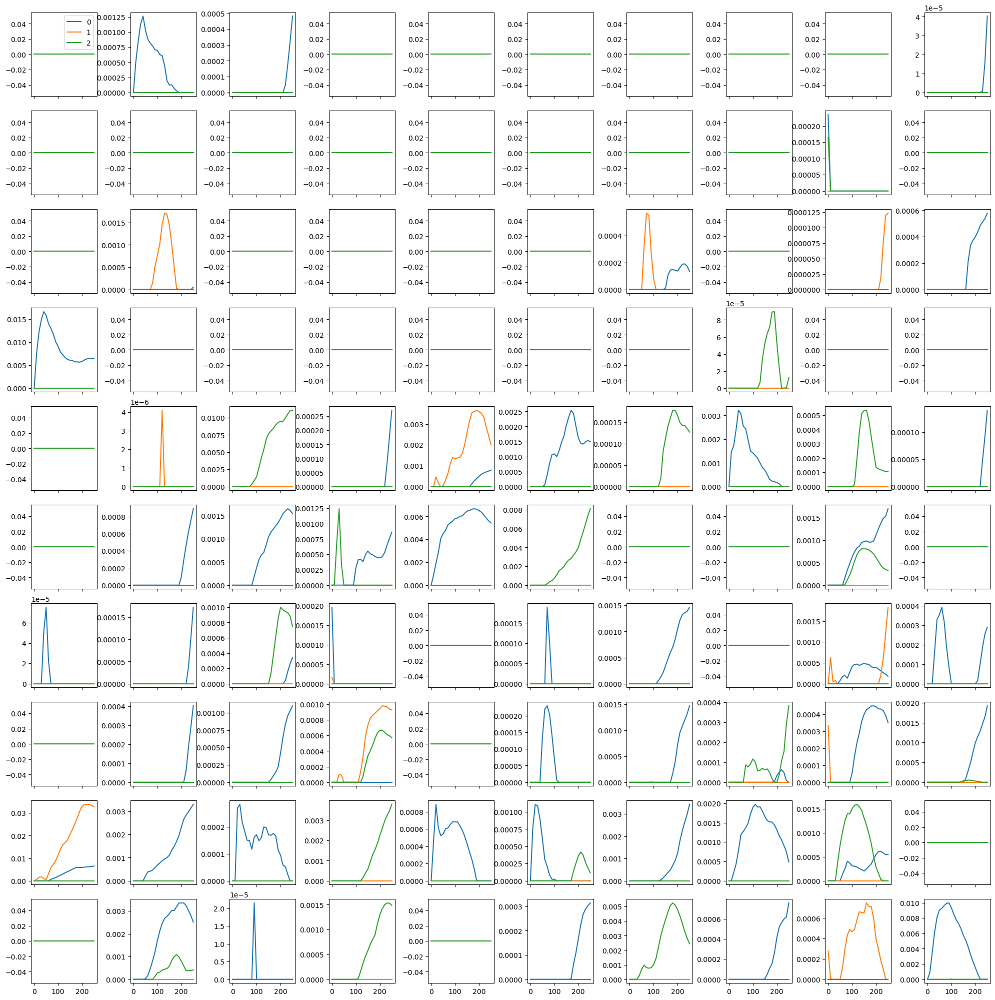

In [96]:

f, axs = plt.subplots(10,10, figsize = (20,20), sharey = False, sharex=True)
plt.tight_layout()
axs = axs.ravel()
for i in range(np.prod(axs.shape)):
    ch = 511 - 59 - i
    for im in range(temp.shape[1]):
        axs[i].plot(sigmas, temp[:,im, :][:,ids_selectivity_sorted[group][sig] ][:,ch], label = im)

axs[0].legend();

## individual channels 

In [97]:

ids = torch.randint(0,len(my_ims), (32,))
inp_ims = my_ims[ids]
noise = torch.randn_like(inp_ims)


if 'gray' in group.split('-'): 
    inp_ims = inp_ims.mean(dim = 1, keepdim = True)

sig = 50
inp_ims_noisy = inp_ims + noise * (sig/255) 
 
acts  = get_activations_unconditional(denoisers[group], noisy_inp)




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


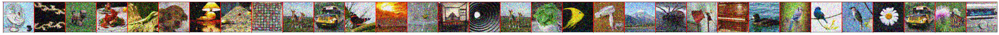

In [98]:
show_im_grid(inp_ims_noisy.cpu()[0:64], n_columns=32 , grid_lines=True)

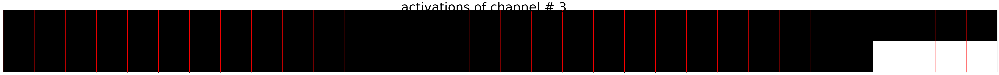

tensor(0.0043)

In [99]:
ch_n = 3
show_im_grid(acts[3][0:64, ch_n:ch_n+ 1].cpu(), n_columns=32 , grid_lines=True,
            label= 'activations of channel # ' +str(ch_n), font_size=30)
ch_selectivity[group][sig][ch_n]

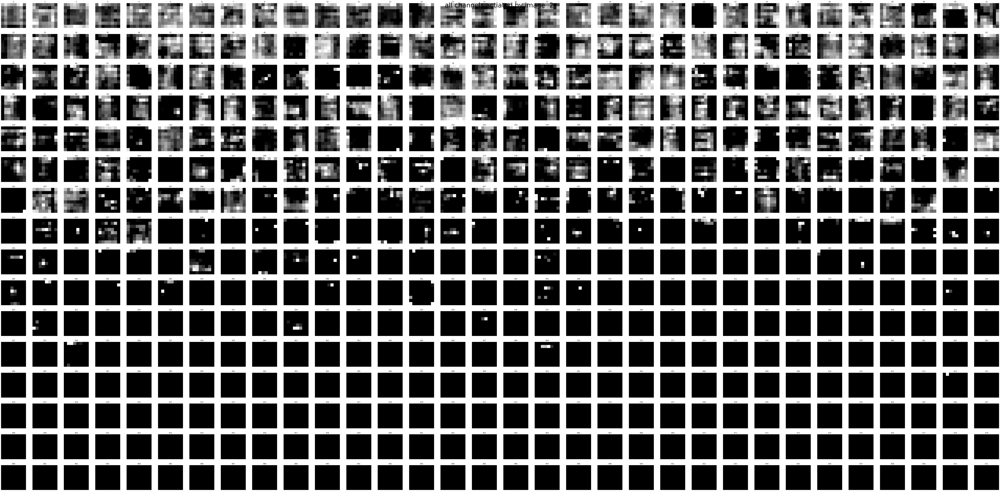

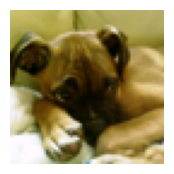

In [100]:
# im_n = 60
im_n = 2
# im_n = 59

show_im_set(acts[3][im_n ].unsqueeze(1).cpu()[ids_selectivity_sorted[group][sig]], n_columns=32 , 
             label= 'all channels actiated by image  ' +str(im_n), font_size=30)
plot_single_im(clean_inp[im_n])

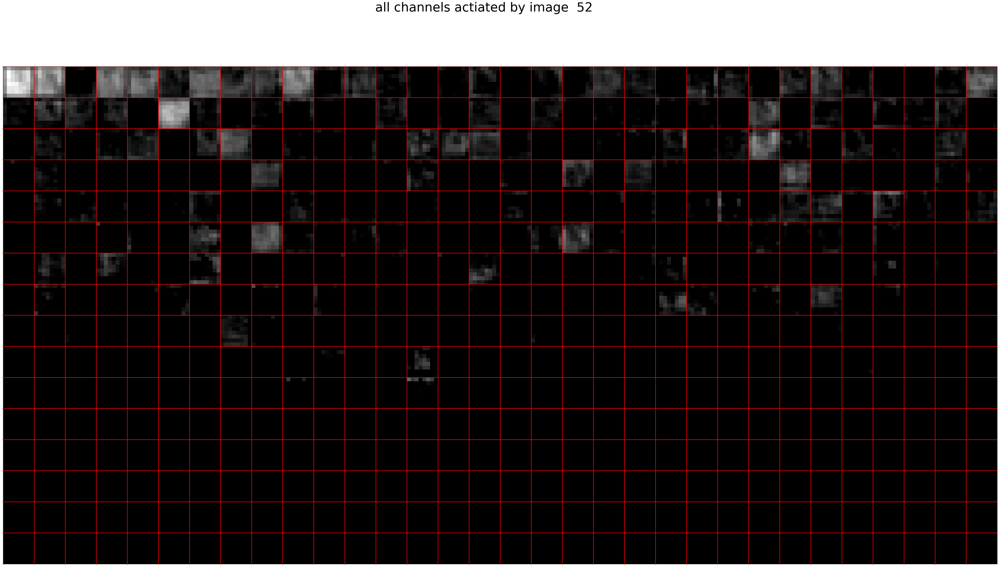

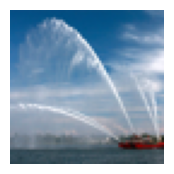

In [94]:
im_n = 52
# im_n = 67
# im_n = 59

show_im_grid(acts[3][im_n ].unsqueeze(1).cpu()[ids_selectivity_sorted[sig]], n_columns=32, grid_lines=True , 
             label= 'all channels actiated by image  ' +str(im_n), font_size=30)
plot_single_im(clean_inp[im_n])

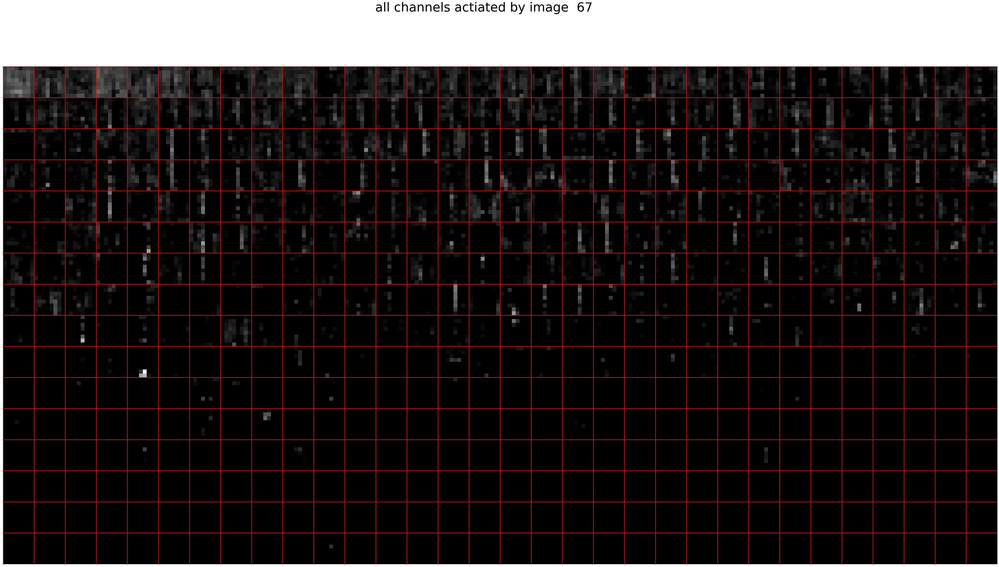

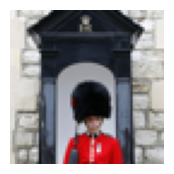

In [34]:
# im_n = 60
im_n = 67
# im_n = 59

show_im_grid(acts[3][im_n ].unsqueeze(1).cpu()[ids_selectivity_sorted[sig]], n_columns=32, grid_lines=True , 
             label= 'all channels actiated by image  ' +str(im_n), font_size=30)
plot_single_im(clean_inp[im_n])

## change of representation seperation at different blocks

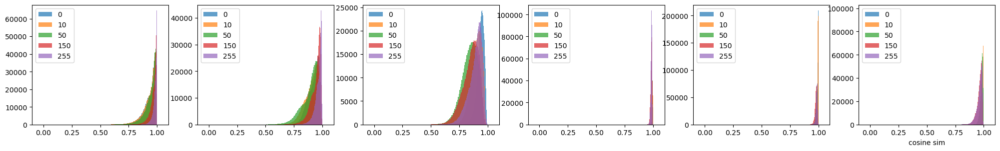

In [71]:
## similarity between phi1 and phi2 at different noise levels and diffrent blocks 
f, axs = plt.subplots(1,6, figsize = (20,3))
plt.tight_layout()
k1 = 0
b = 0
ids = torch.randint(0, test_sets_cat.shape[0], size = (10,))

ave_sims = []
for l in [64, 128, 256, 512, 256, 128]:     
    temp =  []
    for sig in sigmas:
        sim_mat = similarity_matrix(torch.cat([a_bars[group][sig][i] for i in range(len(a_bars[group][sig]))])[:,k1:k1 + l] ).cpu()
        temp.append(sim_mat.mean())        
        axs[b].hist(sim_mat[ids].flatten() , bins = 100, label = sig, alpha = .7);            
        axs[b].legend()
        axs[b].set_xlim(-.1,1.1)
    k1 += l     
    b += 1
    ave_sims.append(torch.stack(temp))
plt.xlabel('cosine sim');

Lower cosine similarity shows higher seperation of $\phi$ for different images. At each block, highest seperation, hence better representation, comes at a different noise level. \
Only at first encoder, seperation is maximized at small noise. \ 
Going deeper into the encoders sigma at which max seperation happens increases. This tell us representation is more informative at higher noise, at deeper blocks. 


Hence, in synthesis: at high noise level, the mid block and one to the last encoder and decoder generate distinct features. As noise goes down, shallower blocks start generating. 



In [280]:
## similarity between phi1 and phi2 at different noise levels and diffrent blocks 
group = 'mixture-color-deep-no-skip-1024mid'
k1 = 0

ave_sims = []
for l in layers[group]:     
    print(l)
    temp =  []
    for sig in sigmas:
        sim_mat = similarity_matrix(torch.cat([a_bars[group][sig][i] for i in range(len(a_bars[group][sig]))])[:,k1:k1 + l] ).cpu()
        triu_indices = torch.triu_indices(sim_mat.size(0), sim_mat.size(1), offset=1)
        upper_triangle = sim_mat[triu_indices[0], triu_indices[1]]
        temp.append(upper_triangle.mean())        

    k1 += l     
    ave_sims.append(torch.stack(temp))


64
128
256
1024
256
128


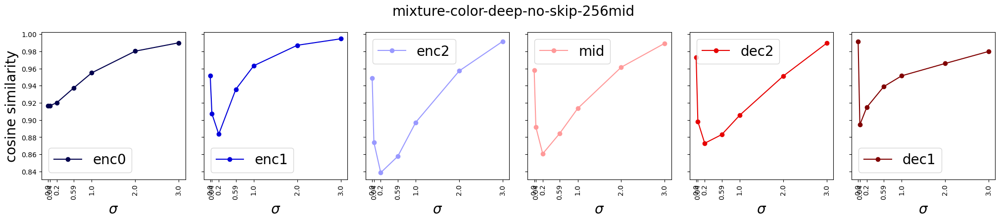

In [279]:
f, axs = plt.subplots(1,6, figsize = (20,4), sharey=True)
f.suptitle(group, fontsize = 20)
plt.tight_layout()

colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [scale_colormap(i) for i in np.linspace(0, 1, len(layers[group]) )]
for b in range(len(layers[group])): 
    axs[b].plot(sigmas, torch.stack(ave_sims)[b], '-o' , color = plot_colors[b])
    axs[b].set_title(block_names[group][b] , fontsize = 20)
    axs[b].set_xlabel('$\sigma$', fontsize = 20)
    axs[b].set_xticks(sigmas)
    axs[b].set_xticklabels(np.round(np.array(sigmas)/255,2 ), rotation=90)
    
    # axs[b].set_xscale('log')
axs[0].set_ylabel('cosine similarity', fontsize = 20);


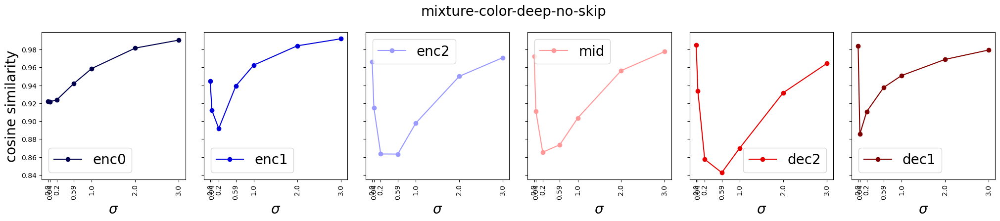

In [277]:
f, axs = plt.subplots(1,6, figsize = (20,4), sharey=True)
f.suptitle(group, fontsize = 20)
plt.tight_layout()

colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [scale_colormap(i) for i in np.linspace(0, 1, len(layers[group]) )]
for b in range(len(layers[group])): 
    axs[b].plot(sigmas, torch.stack(ave_sims)[b], '-o', label =block_names[group][b] , color = plot_colors[b])
    axs[b].legend(fontsize = 20)
    axs[b].set_xlabel('$\sigma$', fontsize = 20)
    axs[b].set_xticks(sigmas)
    axs[b].set_xticklabels(np.round(np.array(sigmas)/255,2 ), rotation=90)
    
    # axs[b].set_xscale('log')
axs[0].set_ylabel('cosine similarity', fontsize = 20);


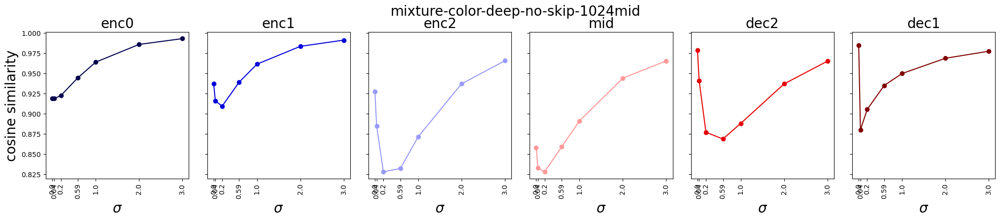

In [281]:
f, axs = plt.subplots(1,6, figsize = (20,4), sharey=True)
f.suptitle(group, fontsize = 20)
plt.tight_layout()

colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [scale_colormap(i) for i in np.linspace(0, 1, len(layers[group]) )]
for b in range(len(layers[group])): 
    axs[b].plot(sigmas, torch.stack(ave_sims)[b], '-o' , color = plot_colors[b])
    axs[b].set_title(block_names[group][b] , fontsize = 20)
    axs[b].set_xlabel('$\sigma$', fontsize = 20)
    axs[b].set_xticks(sigmas)
    axs[b].set_xticklabels(np.round(np.array(sigmas)/255,2 ), rotation=90)
    
    # axs[b].set_xscale('log')
axs[0].set_ylabel('cosine similarity', fontsize = 20);


model with higher ambient dim at mid block creates more seperation at intermediate noise levels. Does this correspond to better samples? 

## How does PR change with noise level? 
PR is stable across noise levels, but not for small noise 

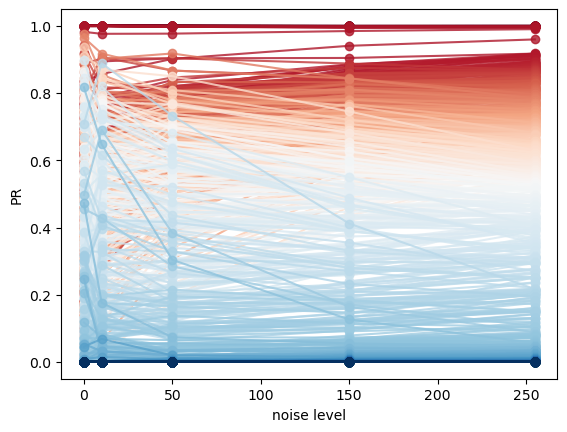

In [79]:
group = 'mixture-color-deep-no-skip-1024mid'
colormap = plt.cm.RdBu  
plot_colors = [colormap(i) for i in np.linspace(0, 1,layers[group][3] )]
i = 0
for id in ids_selectivity_sorted[group][255][0:layers[group][3]]:
    
    temp = torch.stack([ch_selectivity[group][sig][id] for sig in [ 0, 10, 50,150,255] ])
    plt.plot([ 0, 10, 50,150,255], temp, '-o', color = plot_colors[i] , alpha = .8)
    i += 1
# for id in ids_selectivity_sorted[group][255][-300:]:
#     temp = torch.stack([ch_selectivity[sig][id] for sig in [ 0, 10, 50,150,255] ])
#     plt.plot([ 0, 10, 50,150,255], temp, '-o', color = plot_colors[i], alpha = .5 )
#     i += 1
plt.ylabel('PR')
plt.xlabel('noise level');

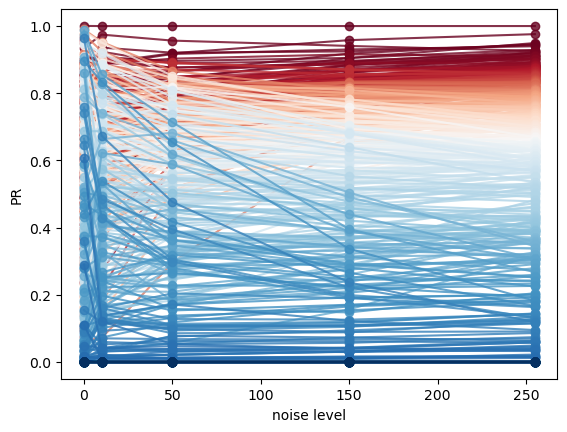

In [82]:
group = 'mixture-color-deep-no-skip-normalized-phi'

colormap = plt.cm.RdBu  
plot_colors = [colormap(i) for i in np.linspace(0, 1,layers[group][3] )]
i = 0
for id in ids_selectivity_sorted[group][255][0:layers[group][3]]:
    
    temp = torch.stack([ch_selectivity[group][sig][id] for sig in [ 0, 10, 50,150,255] ])
    plt.plot([ 0, 10, 50,150,255], temp, '-o', color = plot_colors[i] , alpha = .8)
    i += 1
# for id in ids_selectivity_sorted[group][255][-300:]:
#     temp = torch.stack([ch_selectivity[sig][id] for sig in [ 0, 10, 50,150,255] ])
#     plt.plot([ 0, 10, 50,150,255], temp, '-o', color = plot_colors[i], alpha = .5 )
#     i += 1
plt.ylabel('PR')
plt.xlabel('noise level');

In [ ]:
'../results/samples_unconditional_64x64_mixture-color-no-skip-deep_texture.pt'

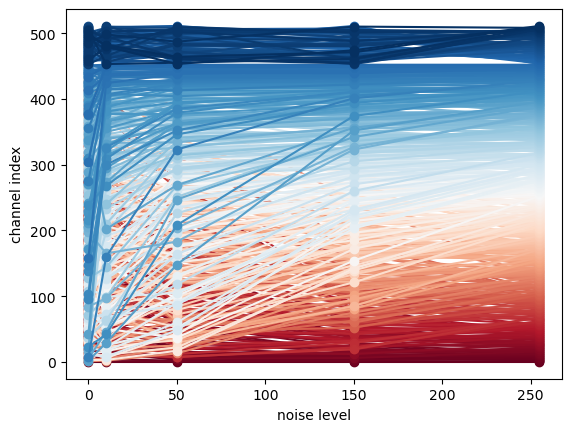

In [76]:
plot_colors = [colormap(i) for i in np.linspace(0, 1,layers[group][3])]
i = 0
for id in ids_selectivity_sorted[group][255][0:512]:
    temp = torch.cat([torch.nonzero(ids_selectivity_sorted[group][sig] == id, as_tuple=False) for sig in [ 0, 10, 50,150,255] ])
    plt.plot([ 0, 10, 50,150,255], temp, '-o', color = plot_colors[i] )
    i += 1
# for id in ids_selectivity_sorted[group][255][-200:]:
#     temp = torch.cat([torch.nonzero(ids_selectivity_sorted[group][sig] == id, as_tuple=False) for sig in [ 0, 10, 50,150,255] ])
#     plt.plot([ 0, 10, 50,150,255], temp, '-o', color = plot_colors[i] )
#     i += 1
plt.xlabel('noise level');
plt.ylabel('channel index');